## Topic-Wise Temporal Sentiment Classification

In this jupyter file, we will use the dataset that we scraped in the ScrapingData.ipynb. This Dataset contains the user reviews of the NHS COVID-19 App from the Google PlayStore. We will begin by preprocessing this data and cleaning it. Then we will use a python library called BERTopic to extract topics from the user reviews. Then we will segregate the reviews according to their topic. Now, For each topic we will use the sentiment classifcation model that we made in SentimentclassificationOfUserReviews.ipynb to predict the sentiment of reviews and create two trendlines where the X-Axis is months and the Y- Axis is either the sum of number of positive sentiments or the sum of total number of negative sentiments.

In [1]:
#conda install pip

In [2]:
'''installing emoji library'''
#!pip install emoji

'installing emoji library'

In [3]:
#! pip install --user bertopic

In [4]:
# pip install numpy --upgrade

In [5]:
#! pip install --user tensorflow

In [6]:
import pandas as pd
import numpy as np
# importing Regular Expressions and Emoji Library
import re
import emoji
# importing BERTopic for Topic Extraction
from bertopic import BERTopic
import hdbscan

In [7]:
covid19_googleplaydata = pd.read_csv('Covid19_GooglePlayData.csv', index_col = 0)
covid19_googleplaydata.head(10)

,reviewId,userName,userImage,content,score,thumbsUpCount,reviewCreatedVersion,at,replyContent,repliedAt
0,805322a3-dcf0-4a33-beaf-d5249b89ad26,Jill Morgan,https://play-lh.googleusercontent.com/a-/AFdZu...,Very useful & supportive.,5,0,4.33 (328),2022-08-03 11:00:46,NaN,NaN
1,5990a1cb-4477-4ccb-a6a6-d7c8597a5522,Robert Luck,https://play-lh.googleusercontent.com/a-/AFdZu...,Lots of bother for little benefit,3,0,4.30 (317),2022-08-02 17:15:19,NaN,NaN
2,2c29bc8b-7c3c-4836-b20e-eb0b4f6bcd47,Audrie Naylor,https://play-lh.googleusercontent.com/a/AItbvm...,I know that u r trying to keep us COVID free. No,4,0,4.33 (328),2022-08-02 11:45:20,NaN,NaN
3,a95cd550-8586-479c-b000-458c5f063d17,Carolyn Ganderton,https://play-lh.googleusercontent.com/a/AItbvm...,"Very good, have been able to check my status i...",4,0,4.33 (328),2022-08-02 09:58:43,NaN,NaN
4,57f6ba68-a5ba-4b6f-9447-b1ab7006b034,A Google user,https://play-lh.googleusercontent.com/EGemoI2N...,Feeling safe,5,0,4.33 (328),2022-08-01 22:57:00,NaN,NaN
5,ca162544-54a0-434b-8800-709c152e0add,Ian Chew,https://play-lh.googleusercontent.com/a-/AFdZu...,Satisfide,5,0,4.27 (297),2022-08-01 19:31:32,NaN,NaN
6,89d45ef1-13bc-4b54-b01e-f3f21e981c91,Stephen Jackson,https://play-lh.googleusercontent.com/a-/AFdZu...,Easy simple effective,5,0,4.33 (328),2022-08-01 12:35:26,NaN,NaN
7,c978d07d-a5da-4bba-8e32-94c24ec9dde2,William Bidwell,https://play-lh.googleusercontent.com/a/AItbvm...,Brilliant,5,0,4.33 (328),2022-08-01 08:32:03,NaN,NaN
8,116752c2-9a50-4d8d-ba0f-be7408487d7c,john robertson,https://play-lh.googleusercontent.com/a-/AFdZu...,Feel more protected now..,5,0,4.33 (328),2022-08-01 08:06:54,NaN,NaN
9,9c3179c8-d7a2-4cff-8adb-7a7c3b7ec48c,Michael Breen,https://play-lh.googleusercontent.com/a/AItbvm...,Good,5,0,4.33 (328),2022-07-31 12:58:42,NaN,NaN


## Data Preprocessing

In [8]:
# Keeping only the content, Rating and timestamp column
covid19_googleplaydata = covid19_googleplaydata[["content","score","at"]]
covid19_googleplaydata.head()

,content,score,at
0,Very useful & supportive.,5,2022-08-03 11:00:46
1,Lots of bother for little benefit,3,2022-08-02 17:15:19
2,I know that u r trying to keep us COVID free. No,4,2022-08-02 11:45:20
3,"Very good, have been able to check my status i...",4,2022-08-02 09:58:43
4,Feeling safe,5,2022-08-01 22:57:00


In [9]:
# Finding Total Null Rows
covid19_googleplaydata.isna().sum()

content    3
score      0
at         0
dtype: int64

In [10]:
# dropping rows with null value in content colum
covid19_googleplaydata.dropna(subset = ['content'],how='any', inplace=True)

In [11]:
#finding the number of rows
covid19_googleplaydata.shape[0]

22795

In [12]:
# Function that will be called to remove emojis
# Ref - https://stackoverflow.com/questions/33404752/removing-emojis-from-a-string-in-python
def remove_emoji(string):
    emoji_pattern = re.compile(
        "["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F923" # Rolling on the floor emoji
        u"\U0001F91E" # Hand with index and middle fingers crossed emoji
        u"\U0001F920" # Cowboy hat emoji
        u"\U0001F92E" # Face Vomiting Emoji
        u"\U0001F914" # Thinking Emoji
        u"\U0001F92C" # Cursing Emoji
        u"\U0001F915" # Face with head-bandage emoji
        u"\U0001F921" # Clown Face EMoji
        u"\U0001F917" # Hugging Face Emoji
        u"\U0001F928" # Face with one eyebrow raised
        u"\U0001F91F" # I love you hand sign emoji
        u"\U0001F989" # Owl Emoji
        u"\U0001F974" # Face with uneven eyes and wavy mouth emoji
        u"\U0001F981" # Lion Face Emoji
        u"\U0001F92F" # Shocked Face with Exploding Head Emoji
        u"\U0001F92A" # Crazy Face Emoji
        u"\U0001F7E9" # Green Square Emoji
        u"\U0001F7E5" # Red Square Emoji
        u"\U0001F7E8" # Yellow Square Emoji
        u"\U0001F7EA" # Purple Square Emoji
        u"\U0001F7E6" # Blue Square Emoji
        u"\U0001F7E3" # Purple Circle Emoji
        u"\U0001F937" # Woman shrug emoji
        u"\u200D" # Zero Width joiner
        u"\U0001F926" # Facepalm emoji
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
        u"\U00002702-\U000027B0"
        u"\U000024C2-\U0001F251"
        "]+",
        flags=re.UNICODE,
    )
    return emoji_pattern.sub(r"", string)

In [13]:
len(covid19_googleplaydata)

22795

In [14]:
# removing emojis
for index, row in covid19_googleplaydata.iterrows():
  text = remove_emoji(row[0])
  covid19_googleplaydata.loc[index, "content"] = text

In [15]:
covid19_googleplaydata

,content,score,at
0,Very useful & supportive.,5,2022-08-03 11:00:46
1,Lots of bother for little benefit,3,2022-08-02 17:15:19
2,I know that u r trying to keep us COVID free. No,4,2022-08-02 11:45:20
3,"Very good, have been able to check my status i...",4,2022-08-02 09:58:43
4,Feeling safe,5,2022-08-01 22:57:00
...,...,...,...
22793,Tells me is installed but not on phone. Can't ...,3,2020-08-13 15:25:10
22794,The emails from the NHS could do a better job ...,4,2020-08-13 15:04:40
22795,Seems to work really well. Super simple setup....,5,2020-08-13 15:03:33
22796,"Not able to install ,code didn't work",1,2020-08-13 14:27:46


In [16]:
# Reset index
covid19_googleplaydata.reset_index(drop = True,inplace = True)
covid19_googleplaydata

,content,score,at
0,Very useful & supportive.,5,2022-08-03 11:00:46
1,Lots of bother for little benefit,3,2022-08-02 17:15:19
2,I know that u r trying to keep us COVID free. No,4,2022-08-02 11:45:20
3,"Very good, have been able to check my status i...",4,2022-08-02 09:58:43
4,Feeling safe,5,2022-08-01 22:57:00
...,...,...,...
22790,Tells me is installed but not on phone. Can't ...,3,2020-08-13 15:25:10
22791,The emails from the NHS could do a better job ...,4,2020-08-13 15:04:40
22792,Seems to work really well. Super simple setup....,5,2020-08-13 15:03:33
22793,"Not able to install ,code didn't work",1,2020-08-13 14:27:46


In [17]:
# Replacing rows with no text in content column with Nan
covid19_googleplaydata = covid19_googleplaydata.replace(r'^s*$', float('NaN'), regex = True)

In [18]:
covid19_googleplaydata

,content,score,at
0,Very useful & supportive.,5,2022-08-03 11:00:46
1,Lots of bother for little benefit,3,2022-08-02 17:15:19
2,I know that u r trying to keep us COVID free. No,4,2022-08-02 11:45:20
3,"Very good, have been able to check my status i...",4,2022-08-02 09:58:43
4,Feeling safe,5,2022-08-01 22:57:00
...,...,...,...
22790,Tells me is installed but not on phone. Can't ...,3,2020-08-13 15:25:10
22791,The emails from the NHS could do a better job ...,4,2020-08-13 15:04:40
22792,Seems to work really well. Super simple setup....,5,2020-08-13 15:03:33
22793,"Not able to install ,code didn't work",1,2020-08-13 14:27:46


In [19]:
covid19_googleplaydata.isna().sum()

content    26
score       0
at          0
dtype: int64

In [20]:
# Dropping rows containing NAN values 
covid19_googleplaydata = covid19_googleplaydata.dropna( axis=0, how='any')
covid19_googleplaydata

,content,score,at
0,Very useful & supportive.,5,2022-08-03 11:00:46
1,Lots of bother for little benefit,3,2022-08-02 17:15:19
2,I know that u r trying to keep us COVID free. No,4,2022-08-02 11:45:20
3,"Very good, have been able to check my status i...",4,2022-08-02 09:58:43
4,Feeling safe,5,2022-08-01 22:57:00
...,...,...,...
22790,Tells me is installed but not on phone. Can't ...,3,2020-08-13 15:25:10
22791,The emails from the NHS could do a better job ...,4,2020-08-13 15:04:40
22792,Seems to work really well. Super simple setup....,5,2020-08-13 15:03:33
22793,"Not able to install ,code didn't work",1,2020-08-13 14:27:46


In [21]:
# Reset index
covid19_googleplaydata.reset_index(drop = True,inplace = True)

In [22]:
covid19_googleplaydata

,content,score,at
0,Very useful & supportive.,5,2022-08-03 11:00:46
1,Lots of bother for little benefit,3,2022-08-02 17:15:19
2,I know that u r trying to keep us COVID free. No,4,2022-08-02 11:45:20
3,"Very good, have been able to check my status i...",4,2022-08-02 09:58:43
4,Feeling safe,5,2022-08-01 22:57:00
...,...,...,...
22764,Tells me is installed but not on phone. Can't ...,3,2020-08-13 15:25:10
22765,The emails from the NHS could do a better job ...,4,2020-08-13 15:04:40
22766,Seems to work really well. Super simple setup....,5,2020-08-13 15:03:33
22767,"Not able to install ,code didn't work",1,2020-08-13 14:27:46


## Process of Extracting Topics

We will use BERTopic library to extract topic. Details of using this library are mentioned in this link - https://github.com/MaartenGr/BERTopic

In [38]:
covid19_googleplaydata_Topics_defaultbertopic = covid19_googleplaydata.copy(deep=True)

In [39]:
#saving reviews and date without time in a separate list variable
sentencesList = covid19_googleplaydata_Topics_defaultbertopic['content'].tolist()

In [40]:
sentencesList[0]

'Very useful & supportive.'

In [41]:
date = covid19_googleplaydata_Topics_defaultbertopic['at'].tolist()

In [42]:
date[0]

'2022-08-03 11:00:46'

In [43]:
print(sentencesList[0])

Very useful & supportive.


In [29]:
# Creating the model

topic_model1 = BERTopic(calculate_probabilities= True)

In [30]:
# Extracting topics
topics1, probabilities1 = topic_model1.fit_transform(sentencesList)

In [31]:
# Save the BERTopic model
topic_model1.save("BertopicModel_default")

C:\Users\amrityap\anaconda3\lib\site-packages\scipy\sparse\_index.py:125: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


In [32]:
# Load the BERTopic model
topic_model1 = BERTopic.load("BertopicModel_default")

In [33]:
# If loading a BERTopic model, run this code to extract topics and their probabilities
# Reference : https://github.com/MaartenGr/BERTopic/issues/283
# In BERTopic v0.9.2 or higher:
topics1= topic_model1._map_predictions(topic_model1.hdbscan_model.labels_)

probabilities1 = hdbscan.all_points_membership_vectors(topic_model1.hdbscan_model)
probabilities1 = topic_model1._map_probabilities(probabilities1, original_topics=True)


In [34]:
topics1

[64,
 296,
 10,
 -1,
 131,
 -1,
 286,
 76,
 8,
 1,
 154,
 -1,
 152,
 20,
 14,
 -1,
 240,
 49,
 3,
 -1,
 60,
 37,
 74,
 131,
 212,
 84,
 1,
 -1,
 8,
 6,
 -1,
 109,
 21,
 39,
 14,
 12,
 114,
 43,
 93,
 76,
 70,
 64,
 97,
 64,
 109,
 74,
 179,
 -1,
 -1,
 39,
 22,
 -1,
 308,
 -1,
 202,
 22,
 14,
 39,
 -1,
 4,
 -1,
 5,
 109,
 5,
 120,
 206,
 246,
 291,
 -1,
 217,
 -1,
 77,
 51,
 60,
 -1,
 -1,
 154,
 21,
 295,
 -1,
 -1,
 -1,
 -1,
 105,
 -1,
 5,
 201,
 -1,
 310,
 1,
 -1,
 22,
 1,
 254,
 202,
 14,
 -1,
 100,
 -1,
 -1,
 208,
 -1,
 291,
 12,
 43,
 5,
 80,
 -1,
 -1,
 2,
 266,
 85,
 189,
 -1,
 81,
 -1,
 1,
 6,
 -1,
 225,
 12,
 -1,
 12,
 -1,
 -1,
 -1,
 -1,
 84,
 106,
 -1,
 -1,
 10,
 -1,
 -1,
 -1,
 135,
 -1,
 -1,
 1,
 -1,
 165,
 86,
 -1,
 21,
 6,
 202,
 12,
 109,
 100,
 -1,
 81,
 -1,
 -1,
 159,
 -1,
 173,
 32,
 274,
 41,
 6,
 1,
 154,
 162,
 15,
 43,
 100,
 5,
 71,
 -1,
 -1,
 82,
 -1,
 131,
 -1,
 119,
 208,
 1,
 99,
 -1,
 17,
 61,
 14,
 -1,
 202,
 179,
 95,
 261,
 1,
 2,
 -1,
 105,
 163,
 -1,
 21,
 

In [35]:
# Printing Topic number, number of reviews per topic and the name of topic
topic_info1 = topic_model1.get_topic_info()
topic_info1

,Topic,Count,Name
0,-1,8480,-1_and_the_it_to
1,0,300,0_postcode_change_risk_area
2,1,278,1_good_goodn_bye_love
3,2,175,2_safe_keep_feel_lives
4,3,171,3_food_lovely_staff_clean
...,...,...,...
310,309,10,309_applied_tt_nhs111_told
311,310,10,310_29122020_cheese_30122020_worrying
312,311,10,311_appbeat_beast_hurt_mixed
313,312,10,312_11_android_0910_linenumber


Topic -1 can be discarded. In Total we have extracted 306 topics. Lets Analyse them

In [36]:
topic_info_Nocount1 = topic_info1[["Topic","Name"]]
topic_info_Nocount1

,Topic,Name
0,-1,-1_and_the_it_to
1,0,0_postcode_change_risk_area
2,1,1_good_goodn_bye_love
3,2,2_safe_keep_feel_lives
4,3,3_food_lovely_staff_clean
...,...,...
310,309,309_applied_tt_nhs111_told
311,310,310_29122020_cheese_30122020_worrying
312,311,311_appbeat_beast_hurt_mixed
313,312,312_11_android_0910_linenumber


In [37]:
topic_model1.get_topic(14)

[('very', 0.28154691691744255),
 ('good', 0.23840187445220004),
 ('really', 0.032935197785122106),
 ('decent', 0.027385208985048717),
 ('expertly', 0.024674908067973275),
 ('aop', 0.024674908067973275),
 ('marvellous', 0.024674908067973275),
 ('mu', 0.022381639969085074),
 ('gameplay', 0.022381639969085074),
 ('jolly', 0.022381639969085074)]

In [38]:
# Checking the Term Score decline for each topic
topic_model1.visualize_term_rank()

The above plot tells us that 9-10 term rank should be sufficient to represent a topic

In [39]:
# Visualising The Terms and their importance for the topic for top 10 topics
topic_model1.visualize_barchart(top_n_topics=10)

In [40]:
topic_model1.visualize_topics()

The above plot indicates there are many topics close to each other. We might need to adjust the hyperparameters to reduces the number of topics

In [41]:
# As BERTopic uses HDBSCAN for clustering the topic clusters are hierarchical
topic_model1.visualize_hierarchy()

In [42]:
# Plotting the heatmap
topic_model1.visualize_heatmap()

The Heat map shows has many tiny blue color spots. These are the spots where topics have high similarity. So there are many topic which are similar. So we need to reduce the number of topics to get a more generalised viewpoint.

## Topics over time

Here we will plot a graph to see how topics vary over a perioid of time.

In [43]:
topics_over_time1 = topic_model1.topics_over_time(docs=sentencesList, 
                                                topics=topics1, 
                                                timestamps=date, 
                                                global_tuning=True, 
                                                evolution_tuning=True, 
                                                nr_bins=20)

In [44]:
topic_model1.visualize_topics_over_time(topics_over_time1, top_n_topics=200)

In [45]:
covid19_googleplaydata_Topics_defaultbertopic['Topic'] = topics1
covid19_googleplaydata_Topics_defaultbertopic

,content,score,at,Topic
0,Very useful & supportive.,5,2022-08-03 11:00:46,64
1,Lots of bother for little benefit,3,2022-08-02 17:15:19,296
2,I know that u r trying to keep us COVID free. No,4,2022-08-02 11:45:20,10
3,"Very good, have been able to check my status i...",4,2022-08-02 09:58:43,-1
4,Feeling safe,5,2022-08-01 22:57:00,131
...,...,...,...,...
22764,Tells me is installed but not on phone. Can't ...,3,2020-08-13 15:25:10,-1
22765,The emails from the NHS could do a better job ...,4,2020-08-13 15:04:40,11
22766,Seems to work really well. Super simple setup....,5,2020-08-13 15:03:33,35
22767,"Not able to install ,code didn't work",1,2020-08-13 14:27:46,212


In [46]:
covid19_googleplaydata_with_topics1 = pd.merge(covid19_googleplaydata_Topics_defaultbertopic,
                                              topic_info_Nocount1,
                                              how='inner',
                                              on = 'Topic')
covid19_googleplaydata_with_topics1

,content,score,at,Topic,Name
0,Very useful & supportive.,5,2022-08-03 11:00:46,64,64_useful_handy_very_important
1,Handy tool,5,2022-07-24 10:01:44,64,64_useful_handy_very_important
2,"Handy, not problems",4,2022-07-24 00:40:31,64,64_useful_handy_very_important
3,Useful,5,2022-06-30 19:52:20,64,64_useful_handy_very_important
4,Very important,5,2022-06-19 10:32:48,64,64_useful_handy_very_important
...,...,...,...,...,...
22764,Downloaded today when it is supposed to be ava...,1,2020-09-24 07:12:01,221,221_iow_today_news_only
22765,Just tried to download after seeing it spoken ...,1,2020-09-24 07:09:41,221,221_iow_today_news_only
22766,Another failure! Massive PR push on the media ...,1,2020-09-24 06:05:58,221,221_iow_today_news_only
22767,"So we are told to download it today, havevfill...",1,2020-09-24 05:15:03,221,221_iow_today_news_only


In [47]:
covid19_googleplaydata_with_topics1.to_csv('covid19_googleplaydata_with_topics1.csv')

In [48]:
covid19_googleplaydata_with_topics1 = pd.read_csv('covid19_googleplaydata_with_topics1.csv', index_col = 0)

In [49]:
covid19_googleplaydata_with_topics1

,content,score,at,Topic,Name
0,Very useful & supportive.,5,2022-08-03 11:00:46,64,64_useful_handy_very_important
1,Handy tool,5,2022-07-24 10:01:44,64,64_useful_handy_very_important
2,"Handy, not problems",4,2022-07-24 00:40:31,64,64_useful_handy_very_important
3,Useful,5,2022-06-30 19:52:20,64,64_useful_handy_very_important
4,Very important,5,2022-06-19 10:32:48,64,64_useful_handy_very_important
...,...,...,...,...,...
22764,Downloaded today when it is supposed to be ava...,1,2020-09-24 07:12:01,221,221_iow_today_news_only
22765,Just tried to download after seeing it spoken ...,1,2020-09-24 07:09:41,221,221_iow_today_news_only
22766,Another failure! Massive PR push on the media ...,1,2020-09-24 06:05:58,221,221_iow_today_news_only
22767,"So we are told to download it today, havevfill...",1,2020-09-24 05:15:03,221,221_iow_today_news_only


## Changing HyperParameters Of BERTopic to get better representation of Topics

As seen above, we can **reduce the number of words for a topic, merge similar topics and reduce hierarcy** to get more generalise and less number of topics

In [23]:
covid19_googleplaydata_Topics_tuningbertopic = covid19_googleplaydata.copy(deep=True)

As we noticed above, stop words are getting included in the topics which is not a desired outcome. So we will use CountVectorizor to remove the stop words and tune it further

In [51]:
from sklearn.feature_extraction.text import CountVectorizer

In [52]:
vectorizer_model = CountVectorizer(stop_words="english")

Training and Saving Bertopic Model

In [53]:
topic_model2 = BERTopic(top_n_words=10,
                                   n_gram_range = (1,3),
                                   min_topic_size = 30,
                                   nr_topics = "auto",
                                   calculate_probabilities= True
                                   )
topics2, probabilities4 = topic_model2.fit_transform(sentencesList)

In [54]:
topic_model2.get_topic_info()

,Topic,Count,Name
0,-1,6163,-1_the_to_and_it
1,0,2446,0_the_notification_to_app
2,1,1007,1_qr_qr code_code_the qr
3,2,930,2_good_good good_very good_excellent
4,3,853,3_easy to use_to use_easy_easy to
...,...,...,...
66,65,39,65_easy_very easy_easy very_easy very easy
67,66,39,66_seems_far seems_so far seems_far
68,67,34,67_background_in the background_the background...
69,68,33,68_the tin_tin_on the tin_says on the


In [55]:
# Printing terms that are highly associated with particular topic
topic_model2.get_topic(0)

[('the', 0.010188695485074844),
 ('notification', 0.009361584722312357),
 ('to', 0.00889092609903257),
 ('app', 0.00860540958752478),
 ('the app', 0.007942984266155605),
 ('and', 0.007696142985400066),
 ('notifications', 0.007640807234385084),
 ('been', 0.007614514505374858),
 ('it', 0.007266611003062709),
 ('in', 0.006988824262737231)]

After training the BERTtopic we are noticing stop words in the text. To avoid that we will update the model by adding Count Vectorizer to remove stop words. Reference - https://maartengr.github.io/BERTopic/getting_started/vectorizers/vectorizers.html

In [56]:
topic_model2.update_topics(sentencesList, topics2, vectorizer_model=vectorizer_model)

In [57]:
topic_model2.get_topic_info()

,Topic,Count,Name
0,-1,6163,-1_app_covid_use_phone
1,0,2446,0_notification_notifications_positive_isolate
2,1,1007,1_qr_codes_code_scan
3,2,930,2_good_excellent_great_fantastic
4,3,853,3_easy_use_simple_great
...,...,...,...
66,65,39,65_easy_difficult_70s_headache
67,66,39,66_far_ok_fine_good
68,67,34,67_background_running_run_optimisation
69,68,33,68_tin_says_does_ulster


We have managed to reduce the number of topics by a great amount. Now will will see some plots such as Term decline per topic, Hierachial, Topic Word Score, Intertopic distance map and Hierchical Clustering

In [58]:
# Saving the tuned version of BERTopic
topic_model2.save("BertopicModel_tuned")

C:\Users\amrityap\anaconda3\lib\site-packages\scipy\sparse\_index.py:125: SparseEfficiencyWarning:

Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.



In [24]:
# Loading BERTopic
topic_model2 = BERTopic.load("BertopicModel_tuned")

In [25]:
# Reference : https://github.com/MaartenGr/BERTopic/issues/283
# In BERTopic v0.9.2 or higher:
topics2= topic_model2._map_predictions(topic_model2.hdbscan_model.labels_)

probabilities2 = hdbscan.all_points_membership_vectors(topic_model2.hdbscan_model)
probabilities2 = topic_model2._map_probabilities(probabilities2, original_topics=True)


In [26]:
topic_info2 = topic_model2.get_topic_info()
topic_info2

,Topic,Count,Name
0,-1,6163,-1_app_covid_use_phone
1,0,2446,0_notification_notifications_positive_isolate
2,1,1007,1_qr_codes_code_scan
3,2,930,2_good_excellent_great_fantastic
4,3,853,3_easy_use_simple_great
...,...,...,...
66,65,39,65_easy_difficult_70s_headache
67,66,39,66_far_ok_fine_good
68,67,34,67_background_running_run_optimisation
69,68,33,68_tin_says_does_ulster


In [27]:
topic_model2.get_topic(5)

[('postcode', 0.09712839233740976),
 ('code', 0.042508245611432696),
 ('post', 0.04235432372890962),
 ('change', 0.03992215812384476),
 ('area', 0.03024799953766236),
 ('risk', 0.028276232034146826),
 ('level', 0.019506318082914233),
 ('accept', 0.019496533446172668),
 ('home', 0.01723256267727542),
 ('postcodes', 0.015072801222390847)]

In [28]:
# Checking the Term Score decline for each topic
topic_model2.visualize_term_rank()

In [29]:
# printing words of top 10 topics
for topic_no in range(0,10):
  print('Topic Number - %d' % topic_no)
  for i in range(0,10):
    if i == 9:
      print('%s.' % (topic_model2.get_topic(topic_no))[i][0], end = ' ')
    else:
      print('%s, ' % (topic_model2.get_topic(topic_no))[i][0], end = ' ')
  
  print('\n')


Topic Number - 0
notification,  notifications,  positive,  isolate,  contact,  tested,  days,  alert,  self,  app. 

Topic Number - 1
qr,  codes,  code,  scan,  scanner,  scanning,  check,  venues,  venue,  places. 

Topic Number - 2
good,  excellent,  great,  fantastic,  amazing,  ok,  awesome,  exnlt,  poo,  cool. 

Topic Number - 3
easy,  use,  simple,  great,  app,  good,  useful,  excellent,  helpful,  really. 

Topic Number - 4
loading,  open,  keeps,  notification,  app,  crashes,  constantly,  tried,  reinstalling,  reinstalled. 

Topic Number - 5
postcode,  code,  post,  change,  area,  risk,  level,  accept,  home,  postcodes. 

Topic Number - 6
bluetooth,  battery,  location,  turn,  gps,  turned,  phone,  services,  drains,  time. 

Topic Number - 7
venue,  check,  midnight,  venues,  checkin,  checked,  option,  left,  checking,  leave. 

Topic Number - 8
isle,  wight,  newham,  available,  volunteers,  england,  scotland,  nhs,  responders,  residents. 

Topic Number - 9


In [68]:
# Visualising The Terms and their importance for the topic for top 10 topics
topic_model2.visualize_barchart(top_n_topics=10)

In [69]:
topic_model2.visualize_topics()

In [32]:
topic_model2.visualize_hierarchy()

In [33]:
topic_model2.visualize_heatmap()

From the plots above its clear that we have got a more generalised version of topics which are not similar to each other. Heat map shows there are very few topics which are similar to each other.

In [34]:
topic_info_Nocount2 = topic_info2[["Topic","Name"]]
topic_info_Nocount2

,Topic,Name
0,-1,-1_app_covid_use_phone
1,0,0_notification_notifications_positive_isolate
2,1,1_qr_codes_code_scan
3,2,2_good_excellent_great_fantastic
4,3,3_easy_use_simple_great
...,...,...
66,65,65_easy_difficult_70s_headache
67,66,66_far_ok_fine_good
68,67,67_background_running_run_optimisation
69,68,68_tin_says_does_ulster


In [35]:
# Adding the topic number for each user review in the dataframe
covid19_googleplaydata_Topics_tuningbertopic['Topic'] = topics2
covid19_googleplaydata_Topics_tuningbertopic

,content,score,at,Topic
0,Very useful & supportive.,5,2022-08-03 11:00:46,50
1,Lots of bother for little benefit,3,2022-08-02 17:15:19,-1
2,I know that u r trying to keep us COVID free. No,4,2022-08-02 11:45:20,18
3,"Very good, have been able to check my status i...",4,2022-08-02 09:58:43,-1
4,Feeling safe,5,2022-08-01 22:57:00,13
...,...,...,...,...
22764,Tells me is installed but not on phone. Can't ...,3,2020-08-13 15:25:10,-1
22765,The emails from the NHS could do a better job ...,4,2020-08-13 15:04:40,8
22766,Seems to work really well. Super simple setup....,5,2020-08-13 15:03:33,10
22767,"Not able to install ,code didn't work",1,2020-08-13 14:27:46,10


In [36]:
# # Adding the topic name for each user review in the dataframe
covid19_googleplaydata_with_topics2 = pd.merge(covid19_googleplaydata_Topics_tuningbertopic,
                                              topic_info_Nocount2,
                                              how='inner',
                                              on = 'Topic')
covid19_googleplaydata_with_topics2

,content,score,at,Topic,Name
0,Very useful & supportive.,5,2022-08-03 11:00:46,50,50_useful_handy_important_kit
1,Handy tool,5,2022-07-24 10:01:44,50,50_useful_handy_important_kit
2,"Handy, not problems",4,2022-07-24 00:40:31,50,50_useful_handy_important_kit
3,Useful,5,2022-06-30 19:52:20,50,50_useful_handy_important_kit
4,Very important,5,2022-06-19 10:32:48,50,50_useful_handy_important_kit
...,...,...,...,...,...
22764,Looks good so far hopefully it's been worth th...,5,2020-09-24 06:39:23,66,66_far_ok_fine_good
22765,Seems good so far,5,2020-09-24 04:36:53,66,66_far_ok_fine_good
22766,seems pretty good,5,2020-09-24 03:00:46,66,66_far_ok_fine_good
22767,Seems decent so far.,5,2020-09-23 23:51:11,66,66_far_ok_fine_good


## Topics over time for Tuned BERTOPIC

In [44]:
topics_over_time2 = topic_model2.topics_over_time(docs=sentencesList, 
                                                topics=topics2, 
                                                timestamps=date, 
                                                global_tuning=True, 
                                                evolution_tuning=True, 
                                                nr_bins=20)

In [45]:
topic_model2.visualize_topics_over_time(topics_over_time2, top_n_topics=50)

In [47]:
covid19_googleplaydata_with_topics2.to_csv('covid19_googleplaydata_with_topics2.csv')

In [48]:
# Saving the User reviews with their topic for the tuned bert model
covid19_googleplaydata_with_topics2 = pd.read_csv('covid19_googleplaydata_with_topics2.csv', index_col = 0)

## Topic Wise Temporal Sentiment Analysis

In [49]:
# Segregating the user reviews by topics.
# Creating a dictionary where key is the topic number and the value is a list containing user reviews, date and score, topic number and topic name
topicwise_lists = {}
number_of_topics2 = len(topic_model2.get_topic_info())
for x in range(0, number_of_topics2):
  for index, row in covid19_googleplaydata_with_topics2.iterrows():
    if x-1 == row[3]:
      if x-1 not in topicwise_lists:
        topicwise_lists[x-1] = [row.to_list()]
      else:
        topicwise_lists[x-1].append(row.to_list())

    

In [50]:
topicwise_lists

{-1: [['Lots of bother for little benefit',
   3,
   '2022-08-02 17:15:19',
   -1,
   '-1_app_covid_use_phone'],
  ['Very good, have been able to check my status immediately with a LFT, although it has always been negative, having elderley relatives and neighbours gives me peace of mind',
   4,
   '2022-08-02 09:58:43',
   -1,
   '-1_app_covid_use_phone'],
  ['Easy simple effective',
   5,
   '2022-08-01 12:35:26',
   -1,
   '-1_app_covid_use_phone'],
  ['Does what it says',
   5,
   '2022-07-29 07:46:23',
   -1,
   '-1_app_covid_use_phone'],
  ['Logistics at its best',
   5,
   '2022-07-28 21:08:57',
   -1,
   '-1_app_covid_use_phone'],
  ['fine', 5, '2022-07-28 16:47:28', -1, '-1_app_covid_use_phone'],
  ['I hope this helps others.',
   5,
   '2022-07-26 15:36:16',
   -1,
   '-1_app_covid_use_phone'],
  ['Its easy to use and it helpful',
   5,
   '2022-07-26 11:14:48',
   -1,
   '-1_app_covid_use_phone'],
  ['I get a very good experience. Many thanks for all the help I have been give

In [51]:
list_of_topicwise_df = []

In [52]:
del topicwise_lists[-1]

In [53]:
# Creating a list of dataframes where each dataframe contains user reviews of a particulat topic
for topicwise_list in topicwise_lists:
  list_of_topicwise_df.append(pd.DataFrame(topicwise_lists[topicwise_list], columns = ['Review', 'Score','Date','Topic_No','Topic_Name']))


In [54]:
list_of_topicwise_df[2]

,Review,Score,Date,Topic_No,Topic_Name
0,Satisfide,5,2022-08-01 19:31:32,2,2_good_excellent_great_fantastic
1,Good,5,2022-07-31 12:58:42,2,2_good_excellent_great_fantastic
2,Very good,5,2022-07-29 12:16:49,2,2_good_excellent_great_fantastic
3,Wonderful,5,2022-07-28 10:42:14,2,2_good_excellent_great_fantastic
4,Super-Dooper!,5,2022-07-27 15:20:34,2,2_good_excellent_great_fantastic
...,...,...,...,...,...
925,Not good,1,2020-09-23 17:45:14,2,2_good_excellent_great_fantastic
926,Excellent,5,2020-09-05 14:01:47,2,2_good_excellent_great_fantastic
927,Excellent,5,2020-08-21 22:14:49,2,2_good_excellent_great_fantastic
928,Good,5,2020-08-21 16:35:09,2,2_good_excellent_great_fantastic


In [55]:
#removing rows with star rating of 3
for topicwise_df in list_of_topicwise_df:
  topicwise_df.drop(topicwise_df[topicwise_df.Score == 3].index, inplace=True)

We have chosen to remove user reveiws where the score given by the user os 3 to the NHS COVID-19 Application. This is done because Our model is trained on Positive and Negative Sentiment only. Where as 3 represents a Neutral Sentiment and prediction of  neutral sentiment is not possoble.

In [56]:
list_of_topicwise_df[2]

,Review,Score,Date,Topic_No,Topic_Name
0,Satisfide,5,2022-08-01 19:31:32,2,2_good_excellent_great_fantastic
1,Good,5,2022-07-31 12:58:42,2,2_good_excellent_great_fantastic
2,Very good,5,2022-07-29 12:16:49,2,2_good_excellent_great_fantastic
3,Wonderful,5,2022-07-28 10:42:14,2,2_good_excellent_great_fantastic
4,Super-Dooper!,5,2022-07-27 15:20:34,2,2_good_excellent_great_fantastic
...,...,...,...,...,...
925,Not good,1,2020-09-23 17:45:14,2,2_good_excellent_great_fantastic
926,Excellent,5,2020-09-05 14:01:47,2,2_good_excellent_great_fantastic
927,Excellent,5,2020-08-21 22:14:49,2,2_good_excellent_great_fantastic
928,Good,5,2020-08-21 16:35:09,2,2_good_excellent_great_fantastic


In [57]:
# Using the Score Column create a label column for sentiment analysis

for topicwise_df in list_of_topicwise_df:
  topicwise_df['Label'] = topicwise_df['Score'].map(lambda x : 0 if x == 4 or x==5 else 1)
  

In [58]:
list_of_topicwise_df[0]

,Review,Score,Date,Topic_No,Topic_Name,Label
0,"Very useful app, puts your mind at ease knowin...",4,2022-07-23 11:49:57,0,0_notification_notifications_positive_isolate,0
1,"I am not a great fan of I.T, but my cousin adv...",5,2022-07-23 01:02:44,0,0_notification_notifications_positive_isolate,0
2,Really good app keeps me up to date with all t...,5,2022-07-22 12:48:43,0,0_notification_notifications_positive_isolate,0
3,Easy set up and very user friendly. Great serv...,5,2022-07-22 07:09:22,0,0_notification_notifications_positive_isolate,0
4,My wife reported her positive test and the app...,1,2022-07-19 07:39:33,0,0_notification_notifications_positive_isolate,1
...,...,...,...,...,...,...
2441,What's the point of trying to persuade me to d...,1,2020-09-18 17:35:35,0,0_notification_notifications_positive_isolate,1
2442,"Not a bad app, it has updated me every time my...",5,2020-09-18 14:31:45,0,0_notification_notifications_positive_isolate,0
2443,Great app! I'm so tired of coronavirus. I thin...,5,2020-09-16 09:29:45,0,0_notification_notifications_positive_isolate,0
2444,This app is rubbish it will Not work at all. T...,1,2020-09-08 17:49:26,0,0_notification_notifications_positive_isolate,1


 Now will will predict sentiment for reviews in each topic

In [59]:
import matplotlib.pyplot as plt
from transformers import DistilBertTokenizerFast
import tensorflow as tf

In [60]:
from transformers import TFDistilBertForSequenceClassification, TFTrainer, TFTrainingArguments

In [61]:
# Load Trained Seniment Prediction Model
model_1 = TFDistilBertForSequenceClassification.from_pretrained("./trainedmodel", local_files_only=True)

All model checkpoint layers were used when initializing TFDistilBertForSequenceClassification.

All the layers of TFDistilBertForSequenceClassification were initialized from the model checkpoint at ./trainedmodel.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFDistilBertForSequenceClassification for predictions without further training.


In [62]:
model_name= "distilbert-base-uncased"

In [63]:
tokenizer = DistilBertTokenizerFast.from_pretrained(model_name)

In [64]:
training_args = TFTrainingArguments(
    output_dir='./results',          # output directory
    num_train_epochs=2,              # total number of training epochs
    per_device_train_batch_size=2,  # batch size per device during training
    per_device_eval_batch_size=2,   # batch size for evaluation
    warmup_steps=500,                # number of warmup steps for learning rate scheduler
    weight_decay=0.01,               # strength of weight decay
    logging_dir='./logs',            # directory for storing logs
    logging_steps=10,
    eval_steps = 10,
    save_total_limit = 2,
)

In [65]:
trainer = TFTrainer(model=model_1, args=training_args)

In [66]:
#perform sentiment analysis on each dataframe and add the positve and negative sentiment column in the dataframe
topicswise_predictedSentiment_list = []

for topicwise_df in list_of_topicwise_df:
  # Write code for predicting sentiment here
    text = list(topicwise_df['Review'])
    label = list(topicwise_df['Label'])
    text_encodings = tokenizer(text, truncation=True, padding=True)
    final_dataset_for_prediction = tf.data.Dataset.from_tensor_slices((
    dict(text_encodings),
    label
    ))
    output = trainer.predict(final_dataset_for_prediction)[0]
    output = np.argmax(output, axis = - 1)
    topicswise_predictedSentiment_list.append(output)

In [70]:
topicswise_predictedSentiment_list

[array([0, 0, 0, ..., 0, 1, 1], dtype=int64),
 array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0,
        0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0,
        1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1,
        1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0,
        1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1,
        1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1,
        1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1,
        1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1

In [71]:
topicwise_sentiment_accuracy = {}
topic_number = 0
for topicswise_predictedSentiment, topicwise_df in zip(topicswise_predictedSentiment_list, list_of_topicwise_df):
    total_correct_sentiments = 0
    for labelled_sentiment, predicted_sentiment in zip(list(topicwise_df['Label']),topicswise_predictedSentiment):
        if labelled_sentiment == predicted_sentiment:
            total_correct_sentiments += 1
    accuracy = (total_correct_sentiments/len(topicwise_df)) * 100
    topicwise_sentiment_accuracy[topic_number] = accuracy
    topic_number += 1

In [85]:
# Accuracy of sentiment prediction for each topic
topicwise_sentiment_accuracy

{0: 90.01419782300047,
 1: 83.11377245508982,
 2: 93.05711086226204,
 3: 97.0131421744325,
 4: 88.37876614060258,
 5: 87.192118226601,
 6: 86.69871794871796,
 7: 82.14936247723132,
 8: 84.93449781659389,
 9: 92.20183486238533,
 10: 94.96221662468514,
 11: 85.48895899053628,
 12: 92.81609195402298,
 13: 93.08176100628931,
 14: 86.59420289855072,
 15: 89.80392156862746,
 16: 93.56223175965665,
 17: 86.52849740932642,
 18: 87.04663212435233,
 19: 97.90575916230367,
 20: 96.68508287292818,
 21: 91.2568306010929,
 22: 85.98726114649682,
 23: 78.52348993288591,
 24: 89.02439024390245,
 25: 91.17647058823529,
 26: 91.33333333333333,
 27: 93.54838709677419,
 28: 87.5,
 29: 81.56028368794325,
 30: 86.23853211009175,
 31: 96.15384615384616,
 32: 92.92035398230088,
 33: 100.0,
 34: 85.29411764705883,
 35: 96.15384615384616,
 36: 85.39325842696628,
 37: 71.73913043478261,
 38: 98.83720930232558,
 39: 88.88888888888889,
 40: 96.1038961038961,
 41: 90.78947368421053,
 42: 90.78947368421053,
 43: 87.

In [73]:
# Topic-wise sentiment prediction Accuracy
topicwise_sentiment_accuracy_df = pd.DataFrame.from_dict(topicwise_sentiment_accuracy.items())
topicwise_sentiment_accuracy_df.columns = ['Topic_Number', 'Accuracy %']
topicwise_sentiment_accuracy_df

,Topic_Number,Accuracy %
0,0,90.014198
1,1,83.113772
2,2,93.057111
3,3,97.013142
4,4,88.378766
...,...,...
65,65,94.736842
66,66,100.000000
67,67,65.217391
68,68,87.500000


In [74]:
list_of_topicwise_df[0]['Date'] = pd.to_datetime(list_of_topicwise_df[0].Date, format='%Y-%m-%d %H:%M:%S')

In [75]:
new = list_of_topicwise_df[0]['Date'].dt.to_period('M')

new.to_frame()

,Date
0,2022-07
1,2022-07
2,2022-07
3,2022-07
4,2022-07
...,...
2441,2020-09
2442,2020-09
2443,2020-09
2444,2020-09


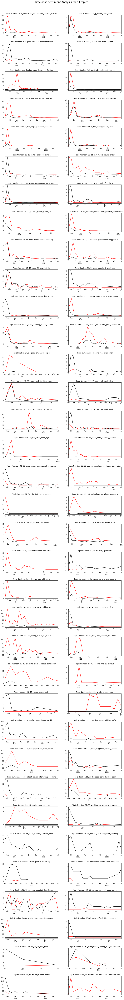

In [76]:
'''For each topic we will use the sentiment classifcation model that we made in SentimentclassificationOfUserReviews.ipynb
to predict the sentiment of reviews and create a two trendline where the X-Axis is month and
the Y- Axis is either the sum of number of positive sentiments or the sum of total number of negative sentiments.'''

plt.figure(figsize=(15, 140))
plt.subplots_adjust(left  = 0.125, right = 0.9, bottom = 0.1 , top = 0.9, wspace = 0.2, hspace = 0.5)
plt.suptitle("Time-wise sentiment Analysis for all topics", fontsize=18, y=0.91)
plt.tight_layout()

for index, (topicswise_predictedSentiment, topicwise_df) in enumerate(zip(topicswise_predictedSentiment_list, list_of_topicwise_df)):
        topicwise_df['Date'] = pd.to_datetime(topicwise_df.Date, format='%Y-%m-%d %H:%M:%S')
        temp_date_and_predSentiment_df = topicwise_df['Date'].dt.to_period('M').to_frame()
        temp_date_and_predSentiment_df['Sentiment'] = pd.DataFrame(topicswise_predictedSentiment, columns = ['Sentiment'])
        timewise_negativeSentiment_perTopic = temp_date_and_predSentiment_df.groupby(['Date']).sum()
        timewise_numberOfSentments_perTopic = temp_date_and_predSentiment_df.groupby(['Date']).count()
        timewise_PositiveSentiment_perTopic = timewise_numberOfSentments_perTopic['Sentiment'] - timewise_negativeSentiment_perTopic['Sentiment']
        '''
        print(timewise_negativeSentiment_perTopic)
        print(timewise_numberOfSentments_perTopic)
        print(timewise_PositiveSentiment_perTopic
        '''
        ax = plt.subplot(40, 2, index + 1)                                                                
        timewise_negativeSentiment_perTopic.plot(ax=ax, color = 'red')
        timewise_PositiveSentiment_perTopic.plot(ax=ax, color = 'black')
        
        ax.set_title('Topic Number: %d, %s' % (index, topicwise_df.iloc[0]['Topic_Name']))
        ax.get_legend().remove()
        ax.set_xlabel("")
                                                                    
    
    


In the above plots red line is the trenline for negative sentiments and the black line is the trendline for positive sentiments.

In [78]:
# If a certain trendline made you curious you can also print which terms were used for the creation of that topic.
topic_model2.get_topic(51)

[('terrible', 0.15839114162121806),
 ('worst', 0.13137436091639929),
 ('rubbish', 0.09512967048267648),
 ('awful', 0.068600389586155),
 ('worse', 0.060532531021561045),
 ('trash', 0.05399410124946672),
 ('app', 0.047647510659969965),
 ('dating', 0.046784396101735556),
 ('graphics', 0.04549327132316288),
 ('software', 0.043899963894247745)]

In [79]:
topic_model2.get_topic(31)

[('open', 0.21908996186622123),
 ('wont', 0.10561048232661639),
 ('crashing', 0.09877773374632873),
 ('crashes', 0.08543707115885514),
 ('keeps', 0.06560511262016507),
 ('opening', 0.049507603754123976),
 ('reinstalled', 0.047705647391301766),
 ('worked', 0.041796261158080814),
 ('opens', 0.040868908390006946),
 ('working', 0.03379011330325035)]

In [80]:
topic_model2.get_topic(32)

[('clear', 0.23222544683193996),
 ('simple', 0.20380397569078726),
 ('understand', 0.15285855824363692),
 ('confusing', 0.1175641793021125),
 ('easy', 0.10571157270555849),
 ('intuitive', 0.08789711443907178),
 ('straight', 0.06831482656544009),
 ('follow', 0.062022135368178404),
 ('forward', 0.05913459047440292),
 ('straightforward', 0.049555930371204954)]

In [81]:
topic_model2.get_topic(36)

[('16', 0.2526532165007541),
 ('age', 0.07506159421715171),
 ('16s', 0.058273351011768885),
 ('school', 0.04144481079274064),
 ('use', 0.0369083252081159),
 ('pegi', 0.029062837407366714),
 ('people', 0.027631045473625982),
 ('children', 0.02720420756548123),
 ('old', 0.026935561306111914),
 ('im', 0.026377052625593894)]

In [82]:
topic_model2.get_topic(42)

[('money', 0.25561214635424423),
 ('waste', 0.2110374904688941),
 ('billion', 0.17944440860652414),
 ('tax', 0.14828255041157612),
 ('payers', 0.13188244587438802),
 ('taxpayers', 0.08472373183110142),
 ('cost', 0.0728917483601801),
 ('wasted', 0.07075245066005284),
 ('worth', 0.06647449832794156),
 ('12b', 0.05700705340469621)]

In [83]:
topic_model2.get_topic(0)

[('notification', 0.025127281533791977),
 ('notifications', 0.022913001967706546),
 ('positive', 0.019157936081617297),
 ('isolate', 0.01898990778913296),
 ('contact', 0.0178084628701322),
 ('tested', 0.017461432190456868),
 ('days', 0.015383638867734757),
 ('alert', 0.01508322914963424),
 ('self', 0.014968394989012798),
 ('app', 0.014123448989108486)]

In [88]:
 pd.set_option('display.max_colwidth', -1)
    # According to the plot above we can focus on a particular topic of interest and analyse that topic.
list_of_topicwise_df[23]

,Review,Score,Date,Topic_No,Topic_Name,Label
0,Uninstalled. 3 jabs later and we're told we'll need more. I've done my part. I'm not doing this for every new variant.,2,2022-07-21 22:06:56,23,23_vaccine_vaccination_jabs_vaccinated,1
3,Don't know why this should be available to rated because let's be honest having an NHS app that contains your proof of vaccinations against a deadly disease is not something we should be proud of having it's a very morbid and negative reminder of what misery it caused so it feels strange rating an app to say yeah it's good at keeping my deadly disease jabs on show,5,2022-06-04 16:47:45,23,23_vaccine_vaccination_jabs_vaccinated,0
4,Did have mild symptoms after my fourth jab . Recved notice of contact 26/5/22,5,2022-05-26 09:09:44,23,23_vaccine_vaccination_jabs_vaccinated,0
5,Truly thankful for vaccinations and the many who gave up their time and risked their health to look after us as without those I'm sure that I would have been in hostpital now probably fighting for my life instead of a home recovery. The app is good but there are fake texts from scammers so more needs to be done for people to identify the true site. Thank you,5,2022-02-27 09:39:06,23,23_vaccine_vaccination_jabs_vaccinated,0
6,My husband hudson kirkham had he's 4th vaccination today 16th Feb 2022,5,2022-02-16 17:35:52,23,23_vaccine_vaccination_jabs_vaccinated,0
...,...,...,...,...,...,...
174,Hate people spying on me. Hate poisonous vaccination. Big No No,1,2020-09-25 00:38:43,23,23_vaccine_vaccination_jabs_vaccinated,1
175,"Don't download because your data is sold to third-parties. There are no safeguards, so protect yourself and mark the app as spam so it gets removed from the app store. Just take your precautions when out as we wait for the vaccine.",1,2020-09-24 17:45:33,23,23_vaccine_vaccination_jabs_vaccinated,1
176,Glad it's working now better late than never hopefully the red tape doesn't cost anymore live to get vaccine.,5,2020-09-24 08:11:23,23,23_vaccine_vaccination_jabs_vaccinated,0
177,"App works for everyone now. Please use it, help trace where (with whom) it sits! Privacy is very clear and transparent. Don't be afraid. Let's make this work, it's an amazing tool tool against something with have no weapons for. N even when the vaccine comes, am sure this app will incorporate it. More who use it, the better it works. #allinthistogether",5,2020-09-24 07:35:28,23,23_vaccine_vaccination_jabs_vaccinated,0
